In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

In [3]:
data_path = "../TabulaSapiensData/"

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


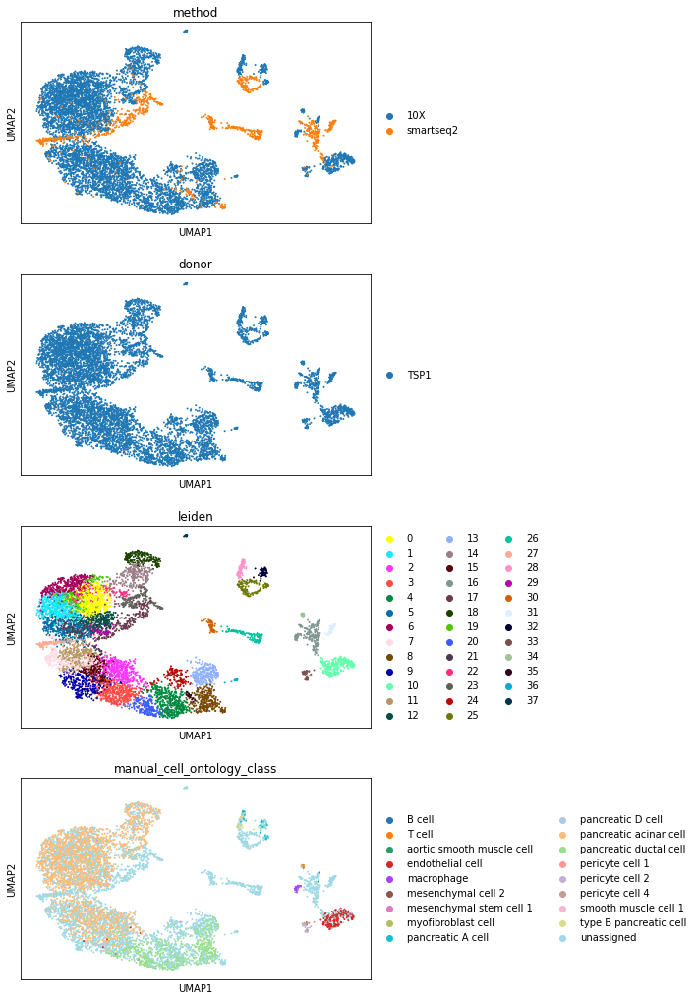

In [5]:
organ = "Pancreas"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

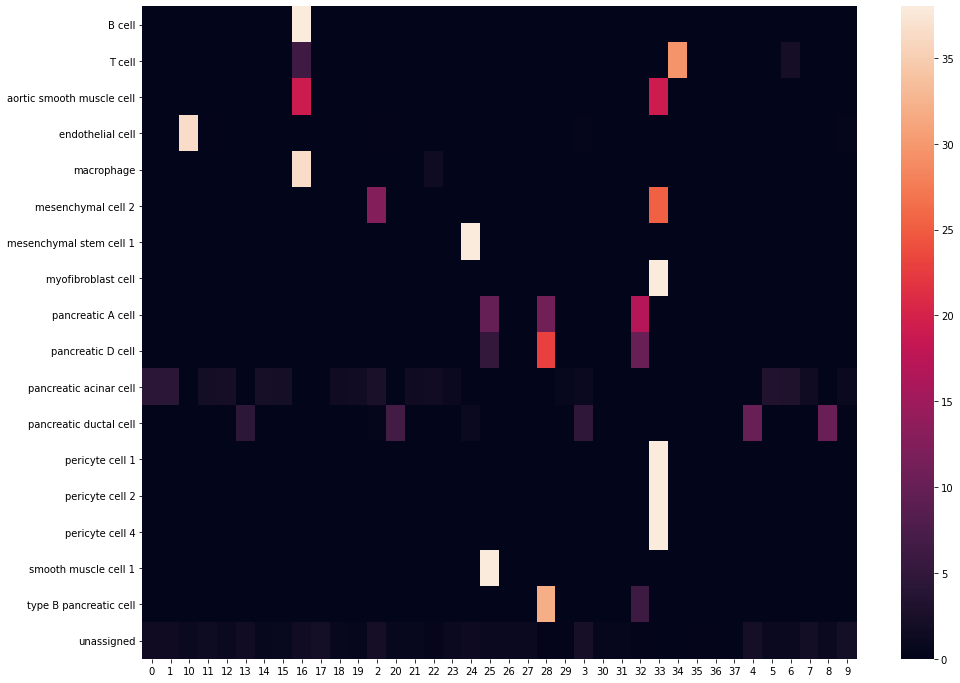

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.mean(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['pancreatic acinar cell: 0.67', 'unassigned: 0.33']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


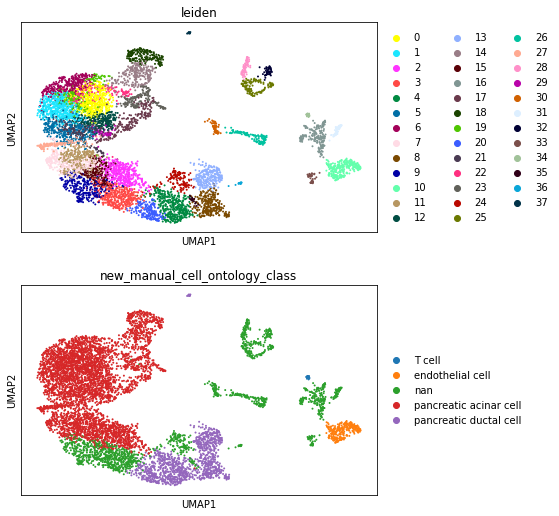

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

# Sankey Diagram between cluster and cell types

In [14]:
from utils.colorDict import donor_colors, method_colors, compartment_colors, tissue_colors

In [15]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [16]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Pancreas.html'

# visualize compartment markers

In [17]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [18]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



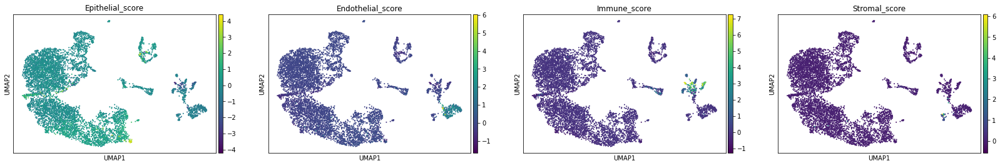

In [19]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [20]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [21]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [22]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [23]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,16.128899,2.185108,9.410142e-54
PRSS3,15.881699,2.525802,2.497536e-52
PRSS1,14.329135,3.621384,1.694300e-42
PRSS2,14.104566,3.416871,3.492693e-41
CELA2B,14.007135,2.561655,1.185625e-40
PLA2G1B,13.658606,2.964803,1.056039e-38
RNASE1,13.324475,1.744616,8.183015e-37
CELA2A,13.014310,2.137866,4.266169e-35
CEL,12.808504,2.897266,5.088431e-34
PRDX4,12.754905,0.817905,8.834828e-34


1


,wilcoxon_score,log fold change,adjusted pvalue
CEL,12.002556,2.857670,6.760101e-30
FAM129A,11.353573,0.864610,9.111156e-27
BACE1,11.134753,0.891922,9.264426e-26
SLC39A14,11.111880,0.827037,1.175499e-25
GATM,10.979657,1.493839,4.859189e-25
ANPEP,10.852793,1.141894,1.897805e-24
EEF2,10.770464,1.009758,4.434908e-24
AZGP1,10.741206,0.824882,5.727729e-24
GSTA2,10.683565,0.935690,1.021932e-23
PABPC4,10.609944,0.792780,2.160521e-23


2


,wilcoxon_score,log fold change,adjusted pvalue
CTRL,4.574858,0.725714,0.000957
GPHA2,4.447061,0.112354,0.001528
AC009078.2,4.329018,0.497230,0.002370
ALB,4.049462,0.477201,0.006069
SERPINI2,3.899982,0.412597,0.009901
CLPSL1,3.865902,0.035937,0.010855
LENG8,3.865594,0.197126,0.010855
PRSS1,3.860775,1.347389,0.010998
CLPS,3.773962,1.329405,0.014288
SYCN,3.655760,1.043518,0.020160


3


,wilcoxon_score,log fold change,adjusted pvalue
FLRT2,25.000711,2.976876,3.535430e-133
ACTN4,24.864332,2.766560,5.327240e-132
AHCYL1,24.623672,2.704075,1.382937e-129
SOX9,24.543478,3.458869,7.472392e-129
APP,24.217138,2.419236,1.728640e-125
SORBS2,23.984892,2.583879,3.922910e-123
S100A13,23.673397,2.951917,5.700852e-120
TUBB,23.634176,2.257602,1.263480e-119
CLDN10,23.618191,2.720248,1.639580e-119
TPM1,23.337629,3.332994,1.083525e-116


4


,wilcoxon_score,log fold change,adjusted pvalue
ANXA4,25.407421,4.564815,1.229179e-137
SPP1,25.150791,3.828633,4.077621e-135
CFTR,24.917452,3.926943,9.446285e-133
ANXA2,24.898926,3.621430,1.124712e-132
AMBP,24.879137,3.507732,1.473590e-132
CITED4,24.779068,3.278401,1.479101e-131
SLC3A1,24.672890,3.318146,1.758290e-130
SLC4A4,24.549021,4.319450,3.260154e-129
ATP1B1,24.488983,3.687456,1.266103e-128
ANXA3,24.373228,3.135767,1.936182e-127


5


,wilcoxon_score,log fold change,adjusted pvalue
CEL,23.475948,4.134898,4.228631e-117
ANPEP,22.017447,2.722419,5.769216e-103
EEF2,21.855066,2.355292,1.218010e-101
GATM,21.847137,2.837488,1.218010e-101
AQP8,21.652884,2.509229,6.722190e-100
KLK1,21.547455,3.370660,5.149479e-99
AC009078.2,21.539017,2.826351,5.149479e-99
GP2,21.536287,4.049202,5.149479e-99
CPA2,21.531624,3.666463,5.149479e-99
PNLIPRP1,21.471693,3.258238,1.685992e-98


6


,wilcoxon_score,log fold change,adjusted pvalue
INSIG1,8.820349,0.697558,2.583569e-16
SEL1L,8.298719,0.716167,1.706742e-14
HYOU1,8.256269,0.980247,2.328431e-14
RNASE1,8.052099,1.329944,1.138052e-13
TENT5C,8.020709,0.673715,1.456328e-13
PDIA4,7.979593,0.637334,1.977828e-13
SLC16A10,7.909133,0.711284,3.331508e-13
GSTA2,7.736304,0.763127,1.172232e-12
BCAT1,7.322219,0.560691,2.315906e-11
PSAT1,7.075205,0.619383,1.262223e-10


7


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,22.319916,2.537407,1.393672e-105
AC009078.2,22.086576,3.176673,1.134006e-103
RBPJL,22.072735,2.740856,1.134006e-103
PABPC4,22.059500,2.614772,1.139627e-103
GATM,21.937628,3.115585,1.338422e-102
RPL9P9,21.859480,2.290430,6.197143e-102
MAN1A2,21.772074,2.350869,3.589945e-101
TPST2,21.613846,2.586544,9.793821e-100
ITPRID2,21.565125,2.429608,2.497927e-99
ERP27,21.547674,2.680904,3.277578e-99


8


,wilcoxon_score,log fold change,adjusted pvalue
TACSTD2,25.663057,5.444454,1.779587e-140
ANXA2,25.352989,5.844337,2.451822e-137
DUSP1,25.122869,5.667529,5.345123e-135
CITED4,25.112501,4.761452,5.345123e-135
ANXA4,24.852362,6.257602,2.870739e-132
ELF3,24.839602,5.043877,3.286485e-132
IER2,24.630451,4.885004,5.014045e-130
FXYD2,24.608654,4.866956,7.510171e-130
ANXA3,24.486263,4.979738,1.353463e-128
TM4SF1,24.469152,4.762493,1.853007e-128


9


,wilcoxon_score,log fold change,adjusted pvalue
LENG8,21.102013,2.503966,4.487137e-94
MT-ND3,20.614264,2.467949,6.016782e-90
NFIC,19.979710,2.143413,1.622893e-84
PBX1,19.805994,2.118374,3.889685e-83
ERGIC1,19.740118,2.239290,1.148553e-82
SNRNP70,19.562668,2.058827,3.157341e-81
PCBP2,19.147211,2.046820,8.587432e-78
EIF4EBP2,18.960157,2.110065,2.679015e-76
XIST,18.652170,2.097251,7.931416e-74
METTL7A,18.608511,1.970318,1.613781e-73


10


,wilcoxon_score,log fold change,adjusted pvalue
PECAM1,27.379925,9.424478,2.800048e-160
PLVAP,27.349298,12.228156,3.240390e-160
RAMP2,27.096476,10.118514,1.971526e-157
IFI27,27.088654,10.233619,1.971526e-157
IGFBP4,26.939833,9.072219,8.836157e-156
SPARCL1,26.895817,9.096551,2.411856e-155
FABP5,26.820215,9.033352,1.579280e-154
A2M,26.799751,7.870388,2.393747e-154
GSN,26.781555,6.412160,3.466781e-154
SPARC,26.698723,8.843838,2.867096e-153


11


,wilcoxon_score,log fold change,adjusted pvalue
CEL,24.282017,4.683418,1.771965e-125
CTRL,24.253862,4.155818,1.771965e-125
SYCN,23.621511,5.165067,4.547028e-119
PRSS1,23.575043,5.668408,1.022994e-118
CLPS,23.439041,5.695690,2.013257e-117
KLK1,23.398024,4.243242,4.391863e-117
CELA2B,23.320253,4.702985,2.323345e-116
MT-ND3,23.127773,2.793294,1.715196e-114
RPL9P9,23.124554,2.599185,1.715196e-114
GPHA2,23.060972,3.223241,6.720570e-114


12


,wilcoxon_score,log fold change,adjusted pvalue
AMY2A,16.909431,2.583413,2.256995e-59
CTRL,16.680067,2.774714,5.386929e-58
CELA2B,16.261890,3.337371,3.610173e-55
PRSS2,16.117395,4.132128,2.833895e-54
PLA2G1B,15.758743,3.637286,7.042127e-52
CELA2A,15.328020,2.931045,4.875417e-49
PRSS3,14.572197,2.964120,3.549804e-44
PRSS1,14.511037,4.068042,7.590464e-44
CELA3B,14.452637,2.458683,1.578174e-43
PNLIP,14.397208,3.693707,3.171671e-43


13


,wilcoxon_score,log fold change,adjusted pvalue
FOSB,22.567209,4.302646,1.030358e-109
ATF3,20.797693,3.928740,3.182637e-93
IER2,20.508505,3.160211,1.195677e-90
ELF3,19.628904,3.226321,5.104907e-83
DUSP1,19.437054,3.244435,2.143926e-81
EGR1,19.236378,2.773067,9.916210e-80
COL18A1,19.123562,2.977606,8.374313e-79
JUNB,18.909029,3.001327,4.835899e-77
JUN,18.306004,2.325248,3.280531e-72
SLC4A4,18.074444,3.655982,2.130398e-70


14


,wilcoxon_score,log fold change,adjusted pvalue
AMY2A,3.542879,0.554156,0.003657
CELA2A,1.840570,0.861758,0.411061
PRSS3,1.776926,0.702788,0.465762
AMY2B,1.317295,0.346922,1.000000
CELA3B,1.292915,0.494153,1.000000
CTRL,1.268252,0.399882,1.000000
AMY1C,0.603297,0.880446,1.000000
CELA2B,0.572214,0.839367,1.000000
PDIA2,0.412006,0.186563,1.000000
PRSS2,0.339494,1.640024,1.000000


15


,wilcoxon_score,log fold change,adjusted pvalue
CEL,15.655344,3.375912,1.798220e-50
AC009078.2,15.394364,2.379330,5.256255e-49
SYCN,15.339544,3.526768,8.165371e-49
CTRL,15.244825,2.685745,2.622777e-48
SPINK1,15.206759,3.465566,3.755261e-48
PRSS1,15.113647,3.978645,1.291694e-47
CTRB1,15.099483,3.600925,1.372576e-47
RNASE1,15.021533,2.386672,3.905004e-47
CLPS,14.993101,3.988010,5.328374e-47
CPB1,14.941916,3.593634,1.035195e-46


16


,wilcoxon_score,log fold change,adjusted pvalue
CD74,21.408751,10.845049,1.303898e-97
HLA-DRA,19.845419,10.620834,3.384199e-84
TMSB4X,19.583271,7.186418,5.268279e-82
B2M,19.289423,6.680291,1.436989e-79
ARHGDIB,17.382084,8.499372,1.702398e-64
HLA-DRB1,16.918177,7.827127,4.323794e-61
HLA-DPA1,16.849884,8.861135,1.316683e-60
ACTB,16.832363,6.307476,1.733533e-60
CD52,16.772236,12.149878,4.496871e-60
LAPTM5,15.277389,8.103945,8.380403e-50


17


,wilcoxon_score,log fold change,adjusted pvalue
AL590556.3,21.165396,10.506976,1.172005e-94
FP671120.5,20.913473,6.837997,1.188446e-92
CELA3A,20.641510,9.171087,2.283534e-90
RPL3P4,20.456430,6.982926,7.749526e-89
RPS28P7,20.258595,7.212212,3.512811e-87
AL512646.1,20.237120,5.534516,4.526645e-87
RPL13P12,19.989557,6.997157,5.710058e-85
GP2,19.443199,7.001818,2.448615e-80
CTRC,19.259884,7.368727,7.629603e-79
CELA3B,19.238375,8.353906,1.039992e-78


18


,wilcoxon_score,log fold change,adjusted pvalue
AMY2A,4.200269,0.749556,0.000314
CELA3B,1.440659,0.449006,0.874961
CELA2A,1.337248,0.766148,1.000000
AMYP1,0.632969,-0.299559,1.000000
CTRL,0.362867,0.238984,1.000000
MARCH11,0.357618,0.830796,1.000000
AMY2B,0.351926,0.166976,1.000000
AC003975.1,0.179755,0.865185,1.000000
DCST1-AS1,0.143212,0.669209,1.000000
AL160262.1,0.122760,21.771252,1.000000


19


,wilcoxon_score,log fold change,adjusted pvalue
ALB,3.269698,0.567857,0.018538
RNASE1,2.606498,0.667320,0.111885
PRSS3,2.543917,0.711746,0.129712
CLPS,2.402155,2.144747,0.178846
CTRB2,2.401703,1.360574,0.178966
CEL,2.359658,1.810548,0.197187
BACE1,2.309037,0.161112,0.220858
ANPEP,2.264547,0.266990,0.243427
CTRL,2.248349,0.541734,0.252311
CTRB1,2.213792,1.930157,0.271312


20


,wilcoxon_score,log fold change,adjusted pvalue
SLC4A4,19.793886,5.435734,1.978599e-82
CFTR,19.593513,4.933979,5.170023e-81
SOD3,19.570848,4.191460,5.378298e-81
ANXA4,19.537296,5.313348,7.787142e-81
SLC3A1,19.489826,4.177551,1.576979e-80
AMBP,19.286135,4.350590,6.890877e-79
CITED4,19.250523,4.191547,1.175261e-78
ALKAL2,19.200220,3.979763,2.711905e-78
SPP1,19.098877,4.566779,1.687439e-77
S100A10,19.061272,4.290214,2.859551e-77


21


,wilcoxon_score,log fold change,adjusted pvalue
IL32,18.921103,3.741905,4.499945e-75
RAB11FIP1,18.175486,3.234725,2.375750e-69
SERPINB1,15.998347,2.463659,2.574810e-53
CTRB2,15.259441,4.084438,2.096682e-48
GSTA1,14.668555,2.358387,1.206887e-44
PACSIN2,14.534701,2.189305,7.165604e-44
VIM,14.315200,2.337136,1.357579e-42
TKT,14.311870,2.002363,1.357579e-42
REG1B,14.005928,5.376034,9.379593e-41
LGALS3,13.918141,1.993853,2.893585e-40


22


,wilcoxon_score,log fold change,adjusted pvalue
AC009078.2,6.173157,1.201443,3.214314e-08
RBPJL,4.985445,0.525747,1.777872e-05
PGGHG,3.821584,0.256746,2.312891e-03
REG3G,3.077628,0.139048,2.716995e-02
RN7SL186P,2.859530,0.256587,5.032593e-02
MT-ND6,2.853073,-0.103407,5.124636e-02
ALB,2.614064,0.457577,9.657554e-02
SERPINI2,2.579033,0.600206,1.055117e-01
PNLIPRP1,2.521848,1.144136,1.214864e-01
CTRB2,2.464069,1.481804,1.395986e-01


23


,wilcoxon_score,log fold change,adjusted pvalue
CELA3B,9.013667,2.406883,1.053100e-17
AMY2A,7.860698,2.142824,1.414362e-13
CELA3A,7.432515,2.669180,3.512164e-12
PNLIPRP1,6.312957,2.565409,6.516712e-09
RBPJL,6.309325,1.948299,6.660729e-09
AMY2B,6.125926,1.711135,2.016562e-08
CELA2A,5.508342,1.911544,6.817255e-07
RN7SL386P,5.469648,2.873569,8.384792e-07
MT-ND1,4.979519,0.984190,1.037753e-05
AC009078.2,4.710800,1.747522,3.721750e-05


24


,wilcoxon_score,log fold change,adjusted pvalue
CFTR,11.872193,2.430744,3.351184e-30
SLC4A4,11.830246,2.734652,5.471974e-30
MT-RNR1,11.649354,1.703670,4.376555e-29
MT-RNR2,10.729527,1.436206,1.067369e-24
ATP1A1,10.451937,2.046983,1.899227e-23
COL18A1,10.223931,1.847415,1.928240e-22
ANXA4,9.942523,1.417120,3.156602e-21
MUC6,8.442547,1.827904,2.389414e-15
ATP1B1,8.412822,1.269813,3.056215e-15
FGFR3,7.711903,1.460629,7.838060e-13


25


,wilcoxon_score,log fold change,adjusted pvalue
TTR,17.438759,12.481684,2.467137e-63
CPE,17.187609,9.299526,2.419692e-62
CHGB,16.603420,10.800522,2.422128e-58
SCG3,16.594149,9.564684,2.597420e-58
MALAT1,16.361084,7.954659,1.016526e-56
SCG2,16.348602,10.764614,1.190966e-56
MT-CO3,15.610507,5.411743,1.346254e-51
MTCO2P2,15.486847,6.892581,8.949573e-51
MTCO2P12,15.268157,6.211656,2.530304e-49
MT-CO2,15.175741,5.138790,1.004642e-48


26


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,13.261823,4.229215,1.036037e-37
S100A9,11.693270,10.735884,2.314045e-29
CSF3R,8.540504,9.425941,8.751184e-16
NAMPT,8.301136,3.719685,6.323645e-15
MALAT1,7.696290,3.109069,7.183045e-13
S100A8,7.101266,8.741207,5.135805e-11
LUCAT1,6.653624,9.765180,1.042395e-09
FYB1,6.536617,6.668922,2.212933e-09
SAT1,6.321174,3.120527,8.522960e-09
IFITM2,6.284139,3.510720,1.065201e-08


27


,wilcoxon_score,log fold change,adjusted pvalue
EEF2,18.126013,6.196828,1.169464e-68
XBP1,17.990074,7.578940,6.859767e-68
GATM,17.948818,8.417040,9.619913e-68
EIF4B,17.880552,7.131390,2.460382e-67
EIF2S3,17.857649,7.751180,2.967474e-67
P4HB,17.810127,7.486160,5.786518e-67
GSTA2,17.786970,7.488831,5.886833e-67
PDCD4,17.779434,6.953290,5.886833e-67
NPM1,17.775179,7.685067,5.886833e-67
RPL5,17.771263,7.191213,5.886833e-67


28


,wilcoxon_score,log fold change,adjusted pvalue
INS,14.779883,17.613417,1.162723e-44
HOPX,14.689100,7.907036,2.228598e-44
MAFA,14.604316,10.485730,4.225187e-44
CHGA,14.598501,9.126569,4.225187e-44
PCSK1N,14.565148,9.920938,5.509862e-44
SCG3,14.505947,8.252627,1.090009e-43
UCHL1,14.483562,7.945720,1.294385e-43
GAD2,14.413921,7.714940,3.029528e-43
CPE,14.407658,7.746547,3.029528e-43
IAPP,14.380463,13.042156,4.040509e-43


29


,wilcoxon_score,log fold change,adjusted pvalue
CELA3B,11.728825,4.767574,5.340094e-27
CELA2A,11.448729,4.821526,7.023790e-26
CELA3A,11.365857,4.758874,1.213786e-25
CEL,10.776015,4.169947,6.576158e-23
AMY2B,10.751417,3.957617,6.871043e-23
AMY2A,10.687619,3.786071,1.141277e-22
CTRL,10.620461,3.486901,2.013134e-22
PRSS2,10.459356,5.077334,9.769095e-22
CTRB2,10.193558,4.423151,1.385836e-20
CPA1,9.944445,4.564025,1.569807e-19


30


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,11.385563,5.512600,1.452581e-25
MT-ATP8,10.839405,5.369009,3.141397e-23
RPL21P28,10.259171,4.144312,7.920009e-21
RPL3P4,9.808816,4.274005,6.073735e-19
MT-TP,9.740171,4.900396,1.087551e-18
RPL6P27,9.705757,3.507846,1.290399e-18
MT-TL1,9.118542,5.264345,2.636754e-16
MT-ND6,9.004154,2.370953,7.108051e-16
AC113935.1,8.892706,3.733184,1.595871e-15
RPL21P16,8.513598,3.021085,3.545175e-14


31


,wilcoxon_score,log fold change,adjusted pvalue
TPSB2,12.323281,20.500799,2.395971e-30
CPA3,12.308624,15.225962,2.395971e-30
TPSAB1,12.086020,21.010370,2.456980e-29
ARHGDIB,11.974655,14.619130,7.100317e-29
FOS,11.859236,11.224019,1.923507e-28
TPSD1,11.849880,17.623032,1.923507e-28
HPGDS,11.844891,16.957710,1.923507e-28
FTH1P8,11.790471,7.223104,2.898484e-28
FTH1P20,11.789317,8.547605,2.898484e-28
FTH1P10,11.771292,6.606776,3.230643e-28


32


,wilcoxon_score,log fold change,adjusted pvalue
CHGA,11.869169,9.066837,1.007614e-27
TTR,11.806912,11.968196,1.058253e-27
CHGB,11.710577,7.734709,1.620894e-27
PCSK1N,11.710577,8.662538,1.620894e-27
SCG2,11.693457,6.572699,1.620894e-27
SCG3,11.609897,6.246977,3.601458e-27
SCG5,11.546732,7.031199,6.448854e-27
NEUROD1,11.502472,6.244623,9.433246e-27
CPE,11.464955,5.595926,1.190384e-26
SLC30A8,11.463075,6.703697,1.190384e-26


33


,wilcoxon_score,log fold change,adjusted pvalue
TPM2,10.972766,8.458105,3.041652e-23
LGALS1,10.837376,6.031169,6.738947e-23
MFGE8,10.755374,8.869852,1.097076e-22
SPARCL1,10.652543,7.335212,2.497057e-22
IGFBP7,10.569883,5.945363,4.839169e-22
CALD1,10.528156,5.584640,6.287064e-22
A2M,10.157798,5.662897,2.572690e-20
GPX3,10.121191,4.667990,3.274413e-20
COL6A2,9.913833,7.763805,2.034561e-19
PLAC9,9.910581,7.592482,2.034561e-19


34


,wilcoxon_score,log fold change,adjusted pvalue
CCL5,8.276632,10.632037,7.459296e-12
CORO1A,8.084005,5.339103,1.792829e-11
PTPRC,8.037939,5.368380,1.792829e-11
S100A4,7.962485,5.671337,2.481634e-11
ARHGDIB,7.761165,3.944423,9.908179e-11
ANXA1,7.582853,4.650323,2.852913e-10
CD7,7.554174,9.258315,2.852913e-10
CCL4,7.549733,8.675911,2.852913e-10
TRBC2,7.494926,6.972809,3.905179e-10
CD69,7.351767,5.714906,7.434862e-10


35


,wilcoxon_score,log fold change,adjusted pvalue
AC090498.1,6.328403,6.529105,0.000015
RPL41P1,5.948915,6.674740,0.000032
MTCO3P12,5.217132,5.191738,0.000684
EEF1A1P5,5.164010,4.720069,0.000791
MT-ATP8,5.019642,4.953672,0.001169
FP671120.5,4.996900,4.091241,0.001169
MTRNR2L12,4.938229,4.750063,0.001450
AC034236.1,4.776941,4.387517,0.002229
ANXA2P2,4.521057,7.517609,0.005250
MTCO1P40,4.355703,3.665361,0.008954


36


,wilcoxon_score,log fold change,adjusted pvalue
CRISP3,6.915015,12.958130,3.031798e-08
MUC5B,6.912523,12.568790,3.031798e-08
CES1,6.905049,9.983166,3.031798e-08
AMN,6.902275,9.433598,3.031798e-08
GPX2,6.887043,8.385726,3.031798e-08
LGALS4,6.886534,8.347080,3.031798e-08
FOLR1,6.885345,7.567698,3.031798e-08
PIGR,6.879910,8.868886,3.031798e-08
AGT,6.874474,7.775519,3.031798e-08
TFF3,6.874361,9.951650,3.031798e-08


37


,wilcoxon_score,log fold change,adjusted pvalue
PPP1R1B,4.671331,2.688716,0.005033
ANXA2,4.270267,3.161148,0.020156
HES4,4.264050,1.899283,0.020156
CCND1,4.135240,2.454256,0.030253
ANXA4,4.033749,3.537141,0.038935
SPP1,4.003854,2.838686,0.042659
CITED4,3.950032,2.654307,0.049464
FXYD2,3.841382,2.058145,0.069254
AMBP,3.812304,2.042335,0.072884
S100A11,3.733297,1.974395,0.091195


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



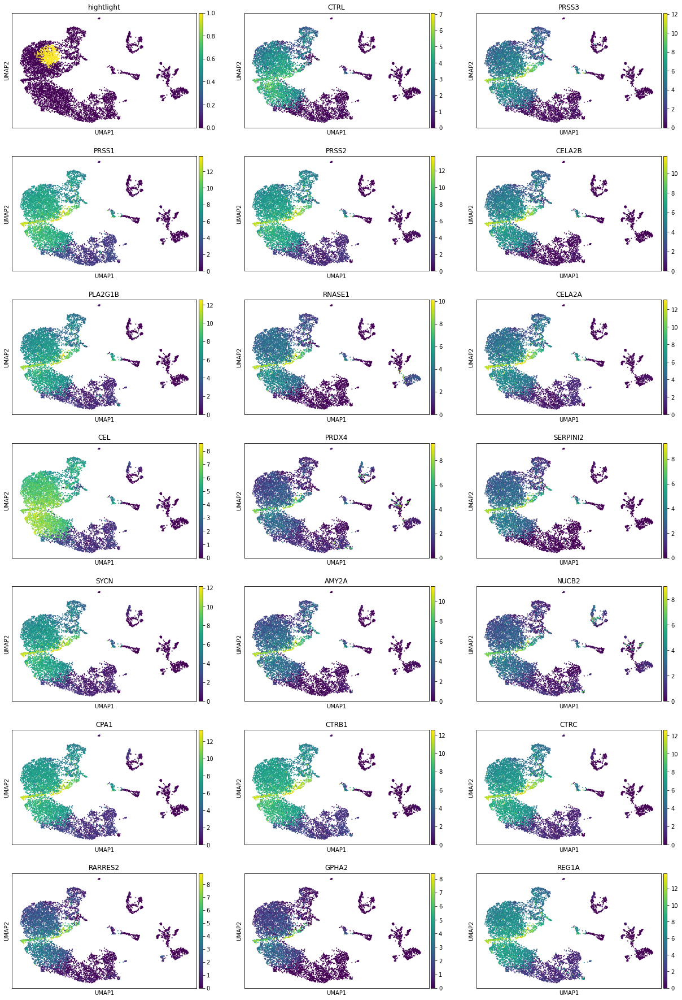

In [24]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


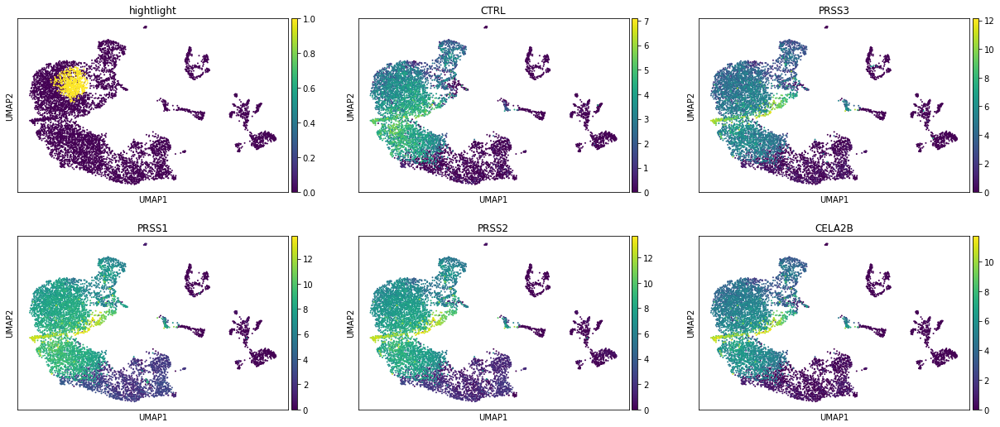

1


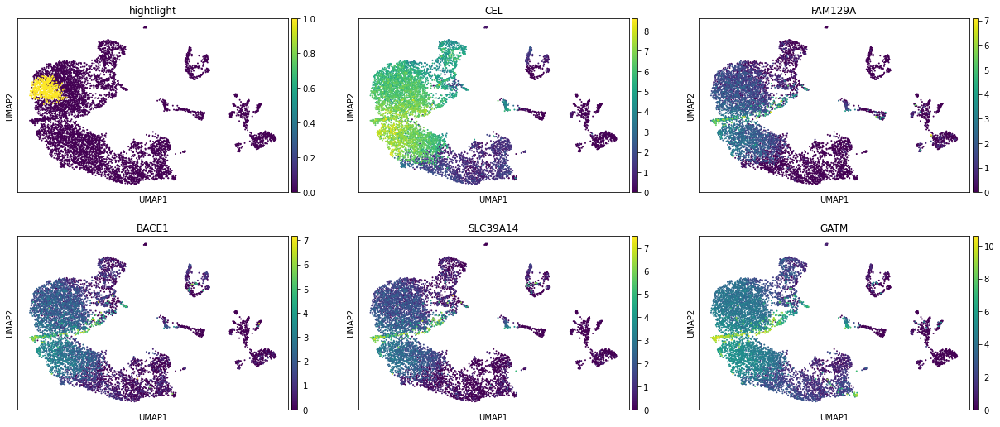

2


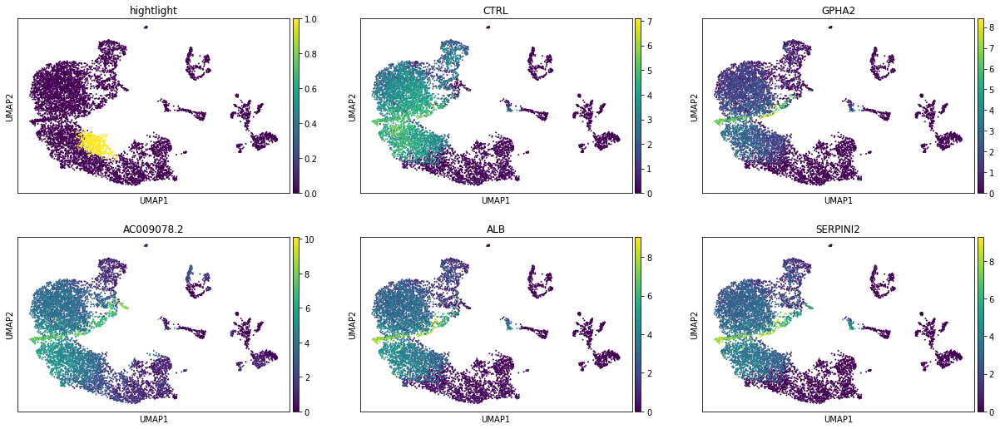

3


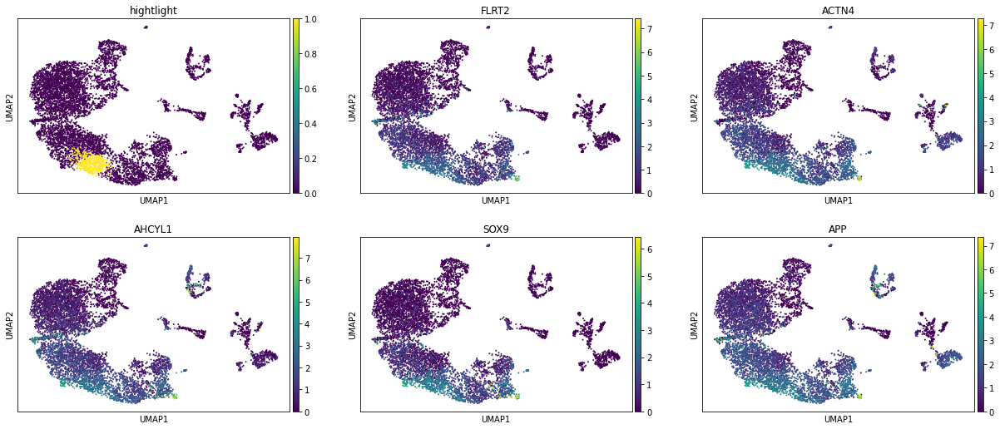

4


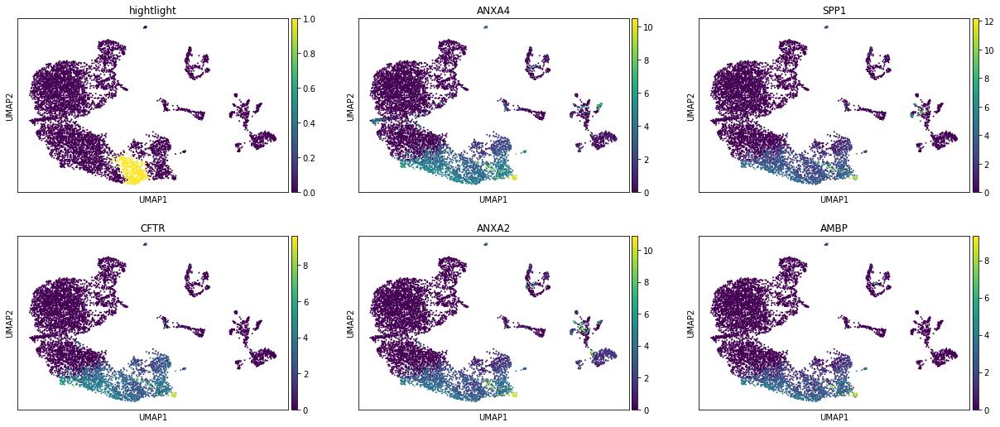

5


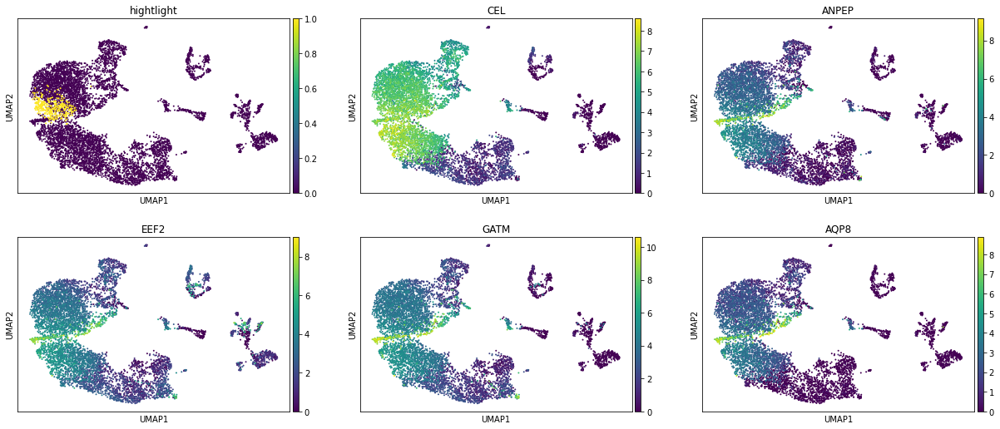

6


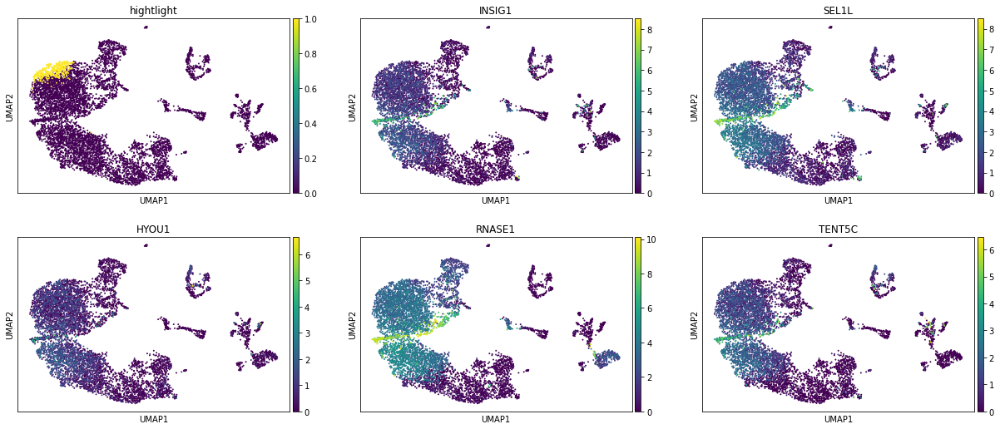

7


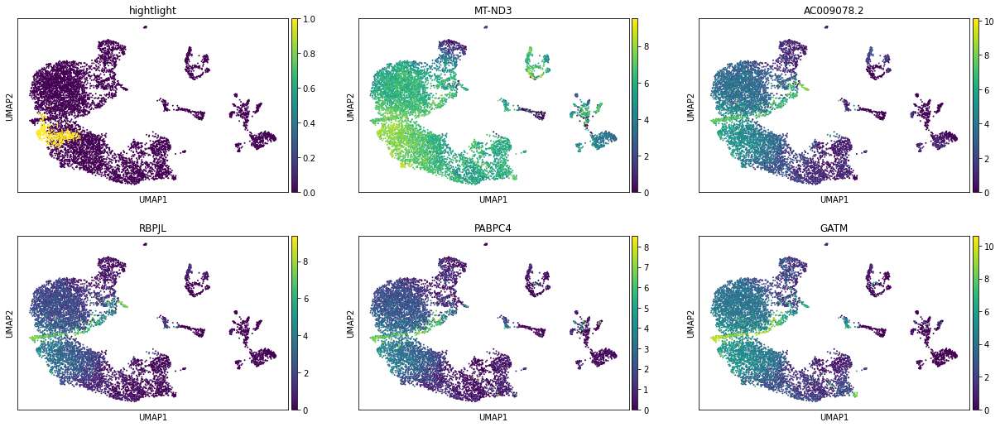

8


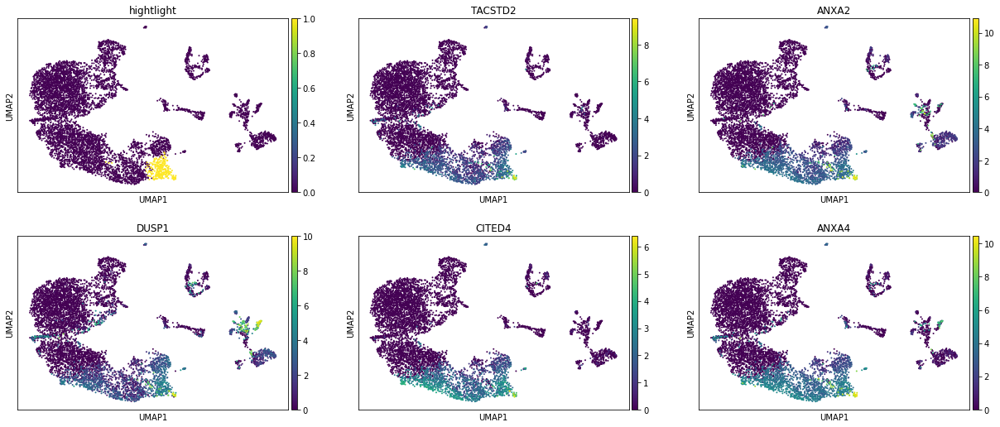

9


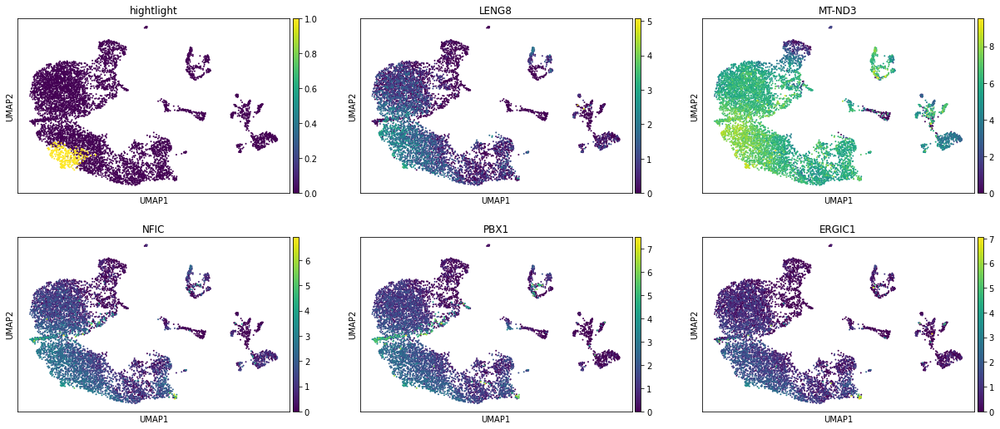

10


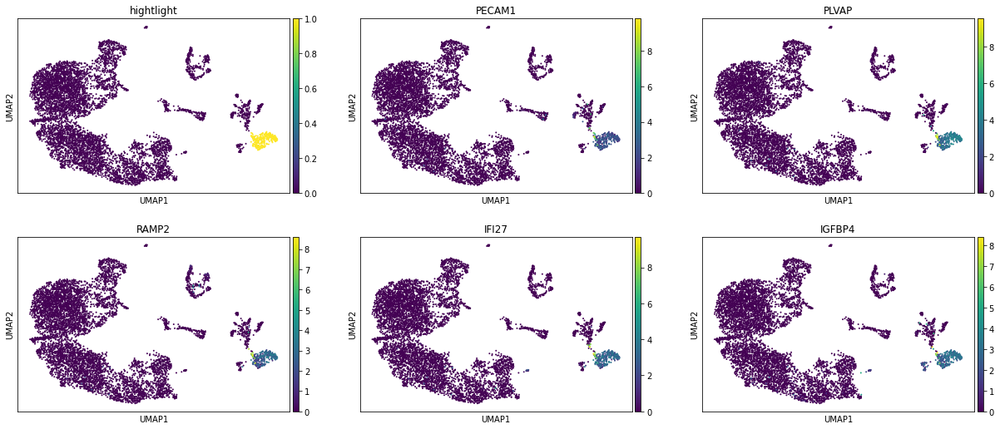

11


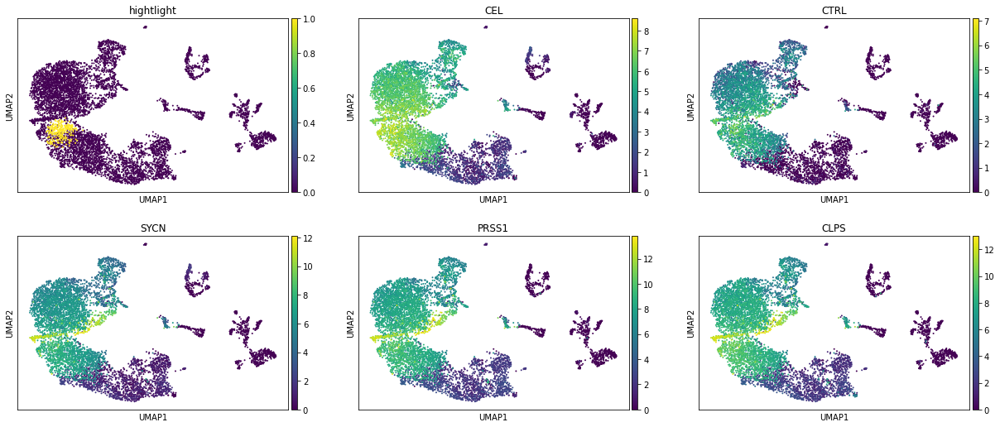

12


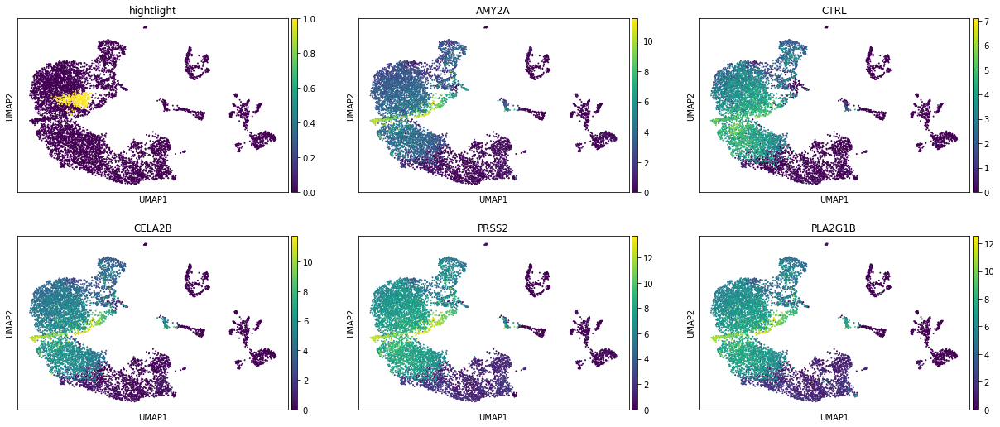

13


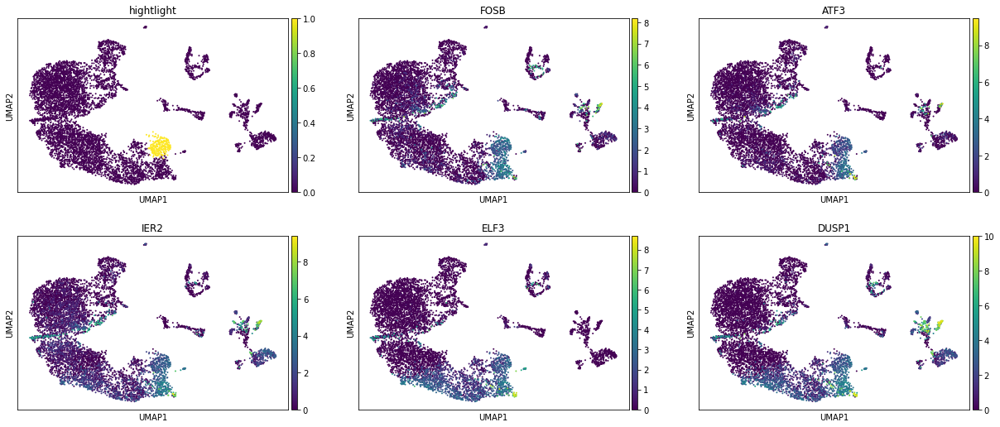

14


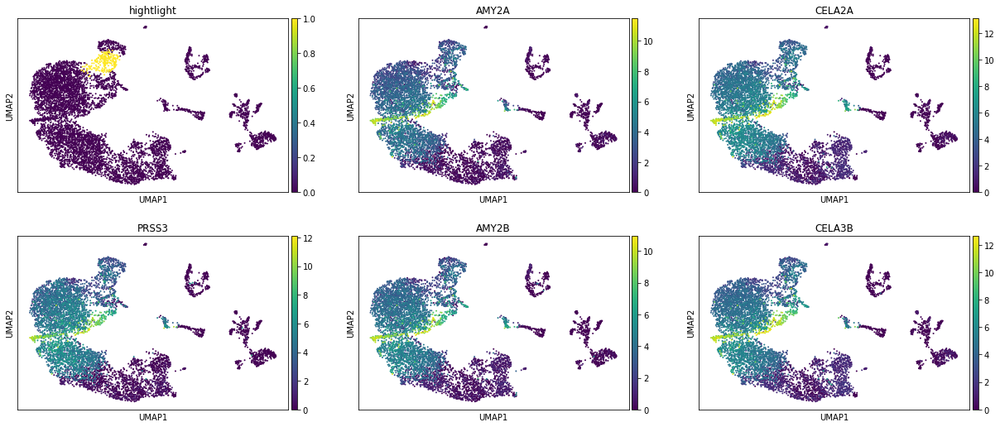

15


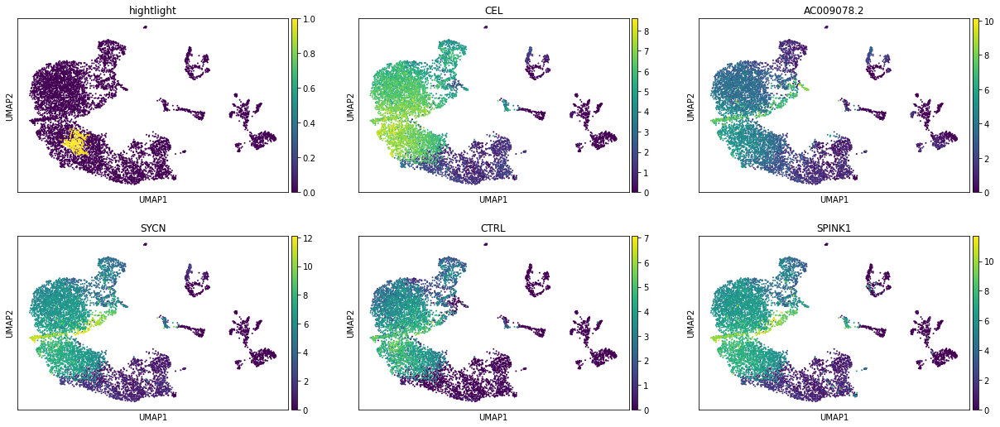

16


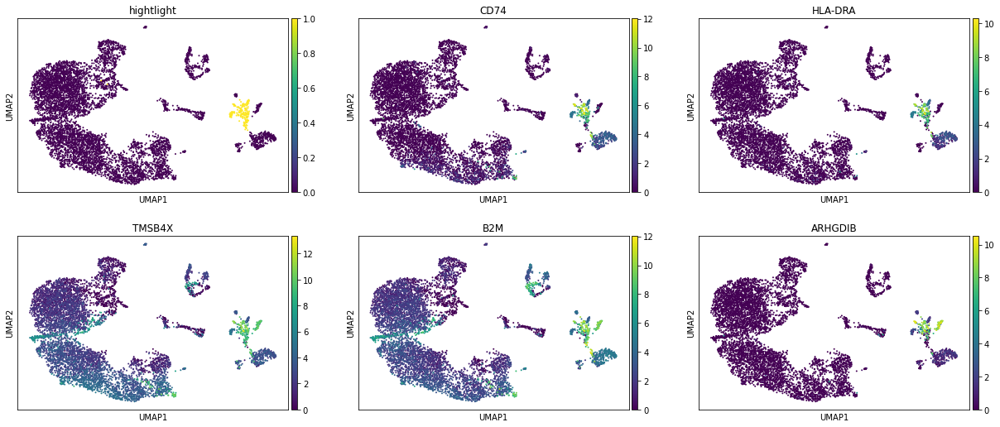

17


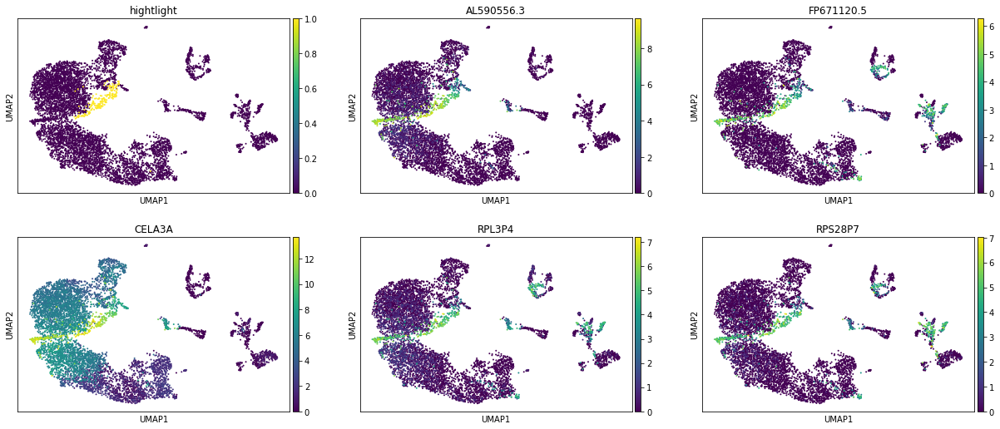

18


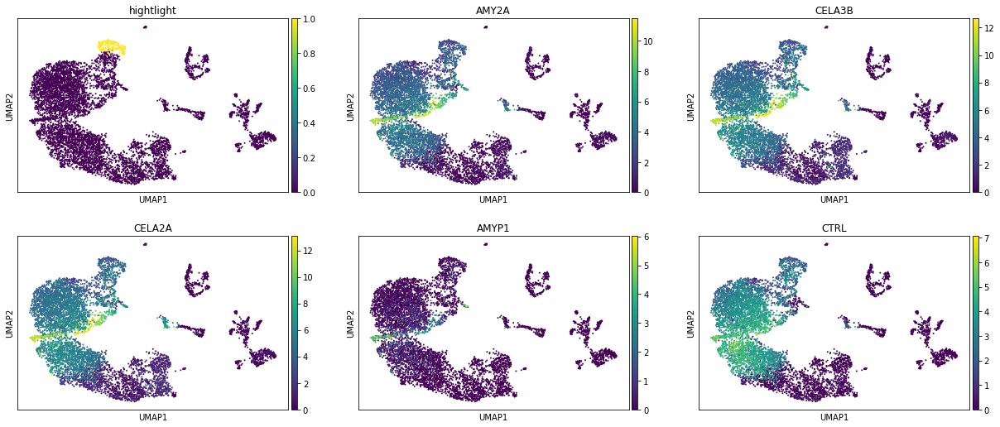

19


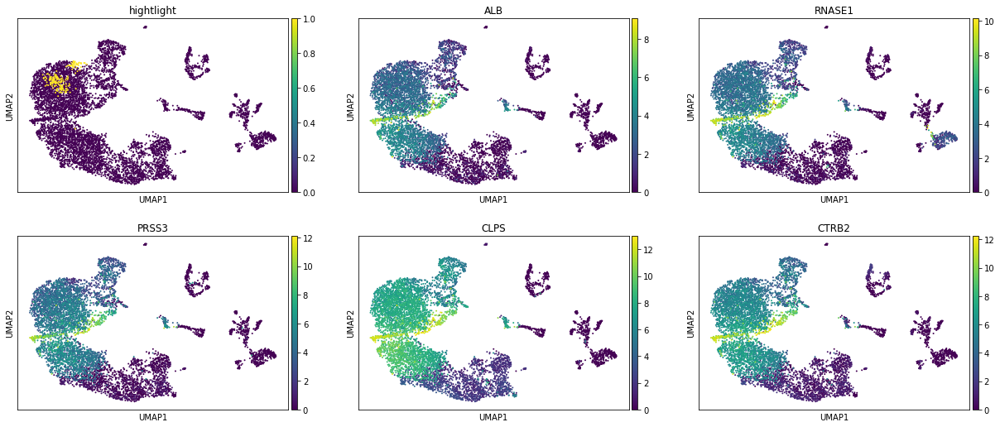

20


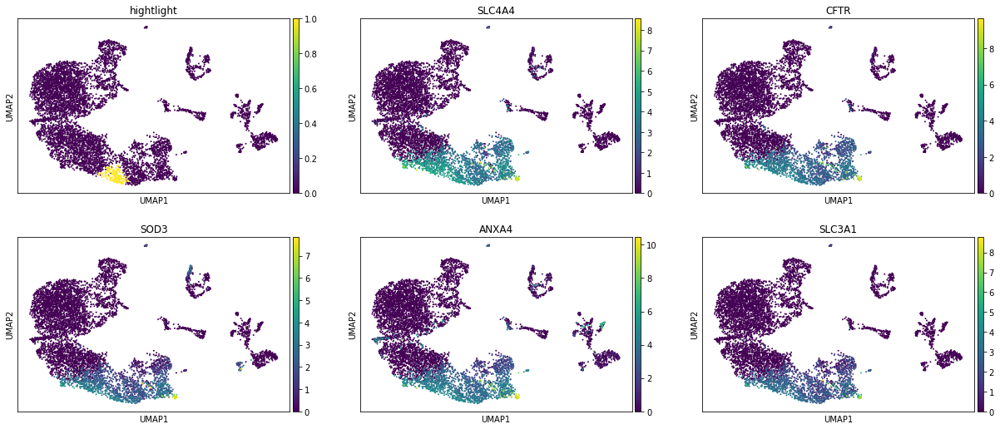

21


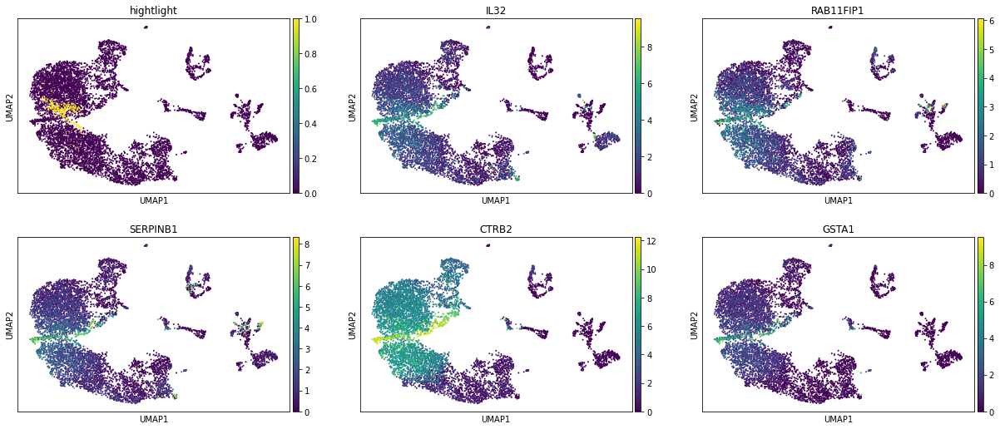

22


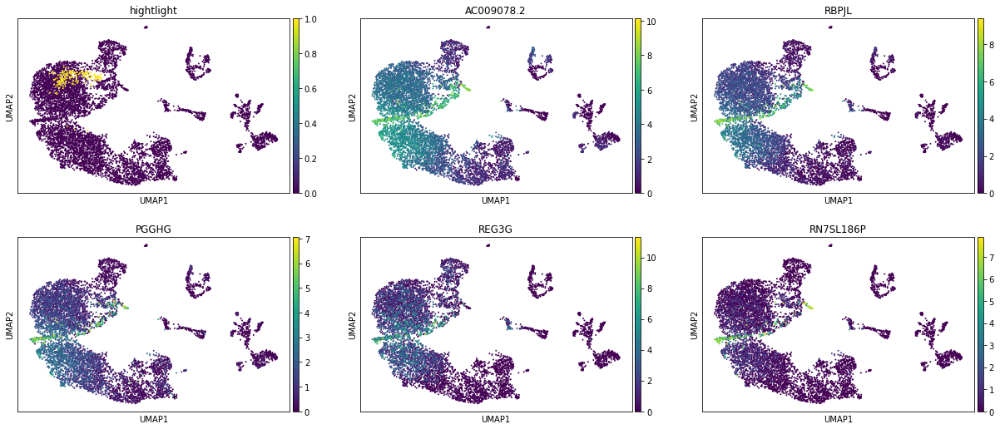

23


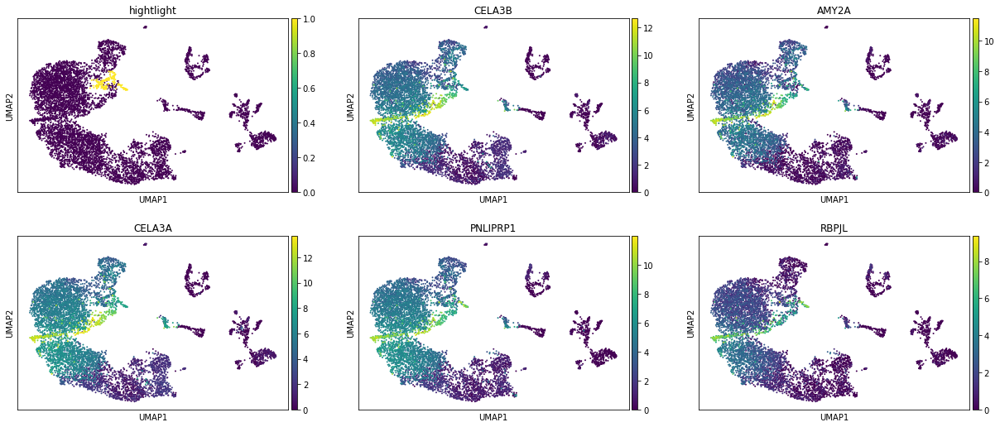

24


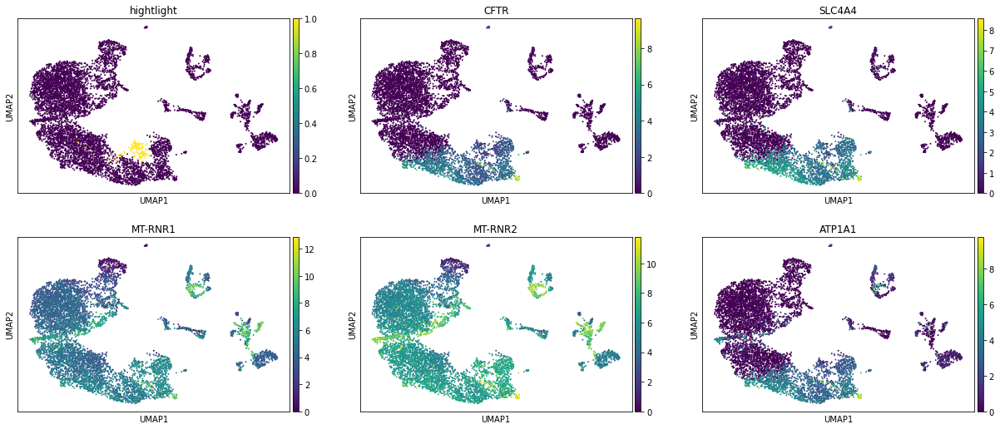

25


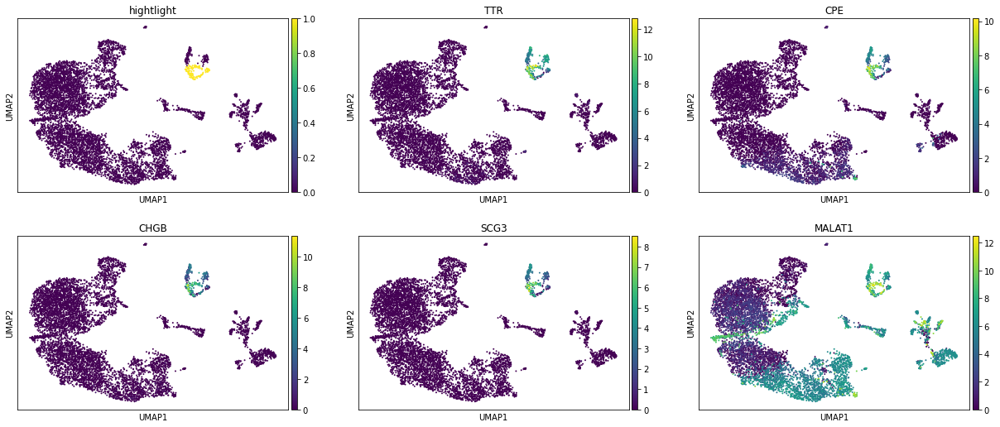

26


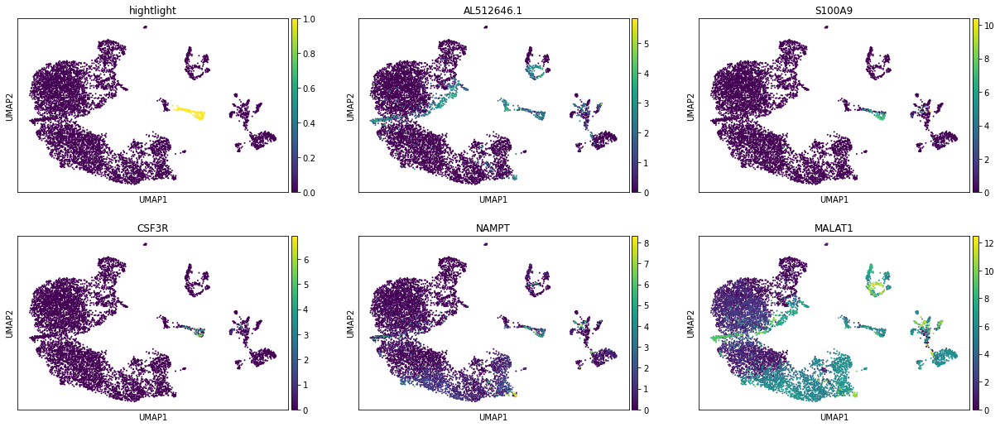

27


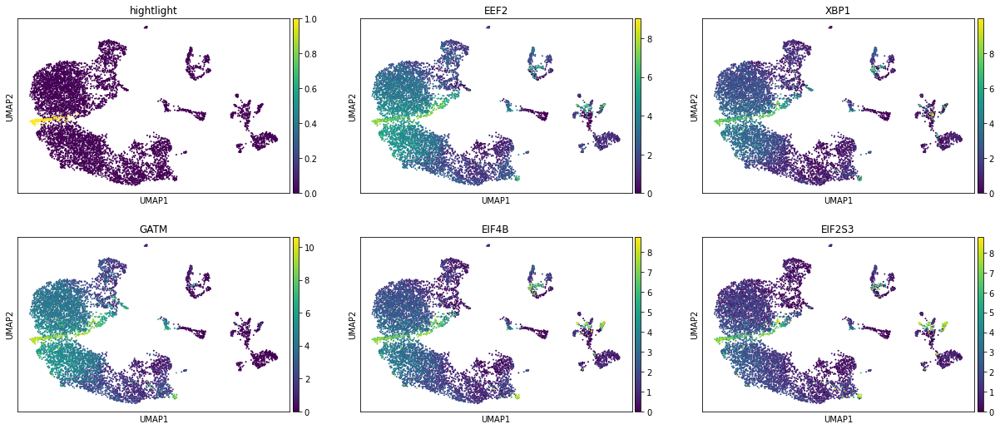

28


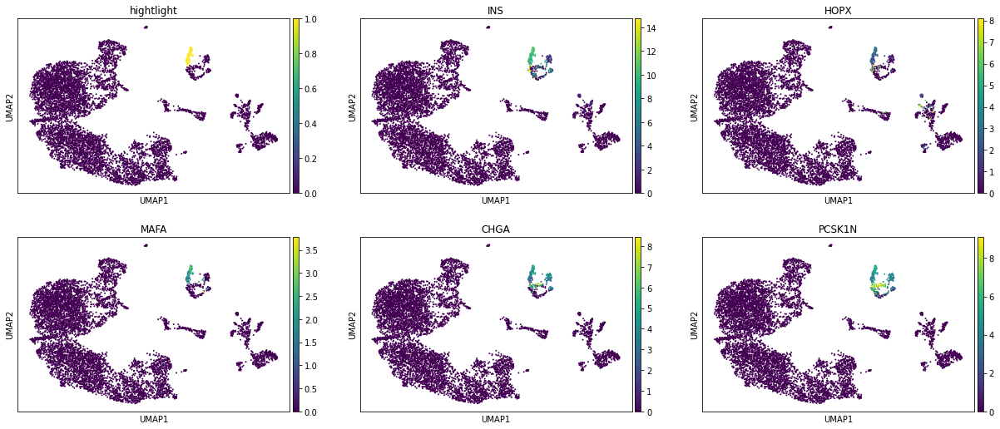

29


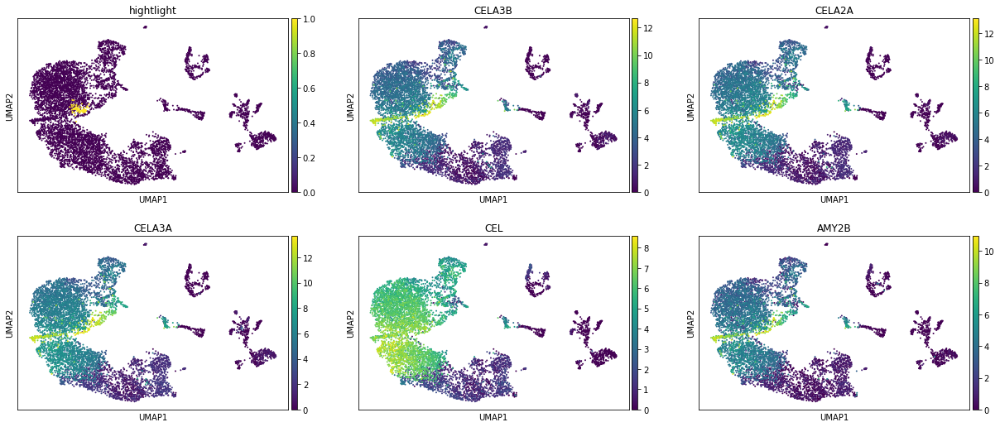

30


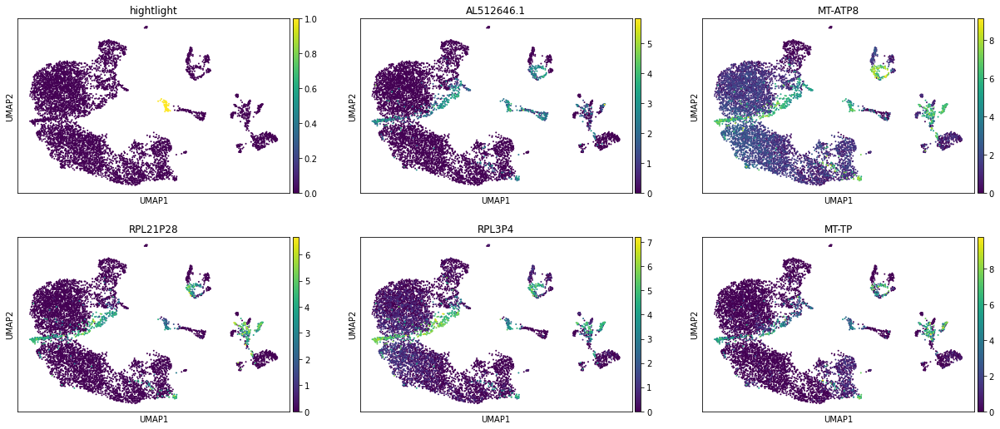

31


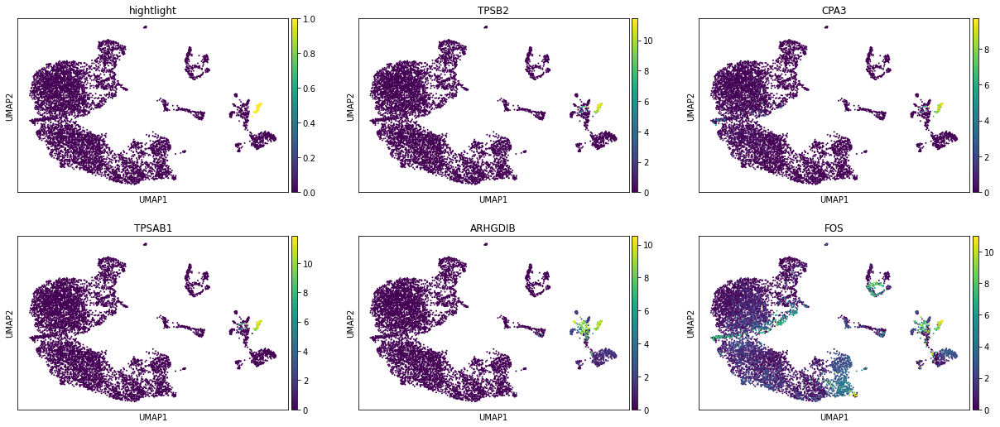

32


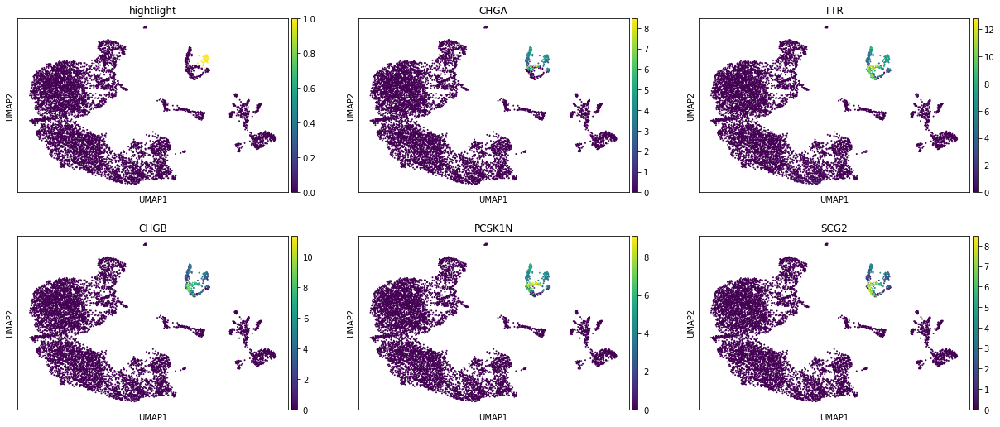

33


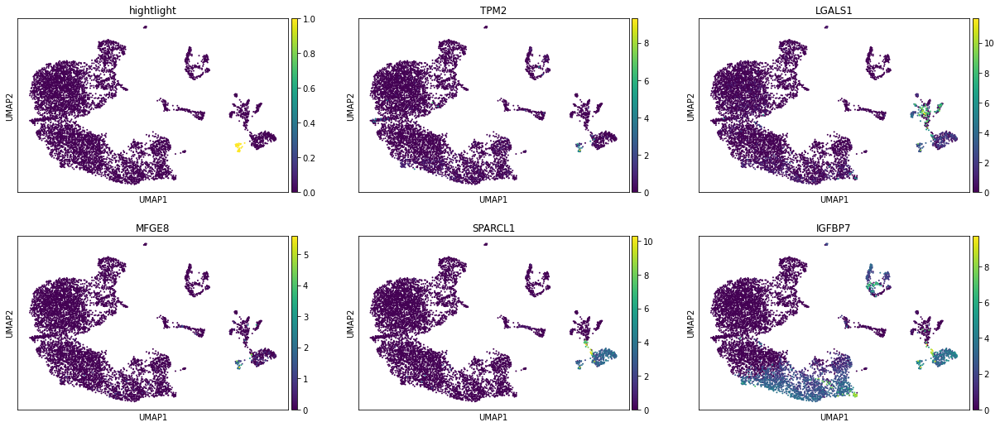

34


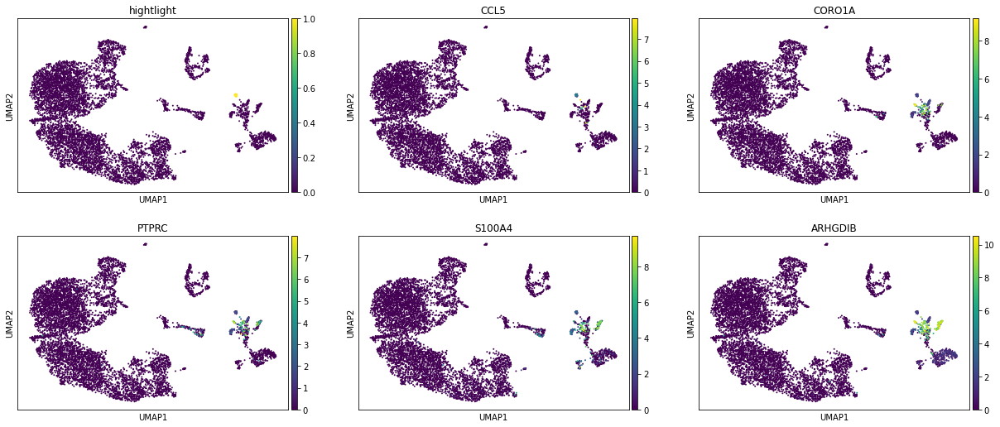

35


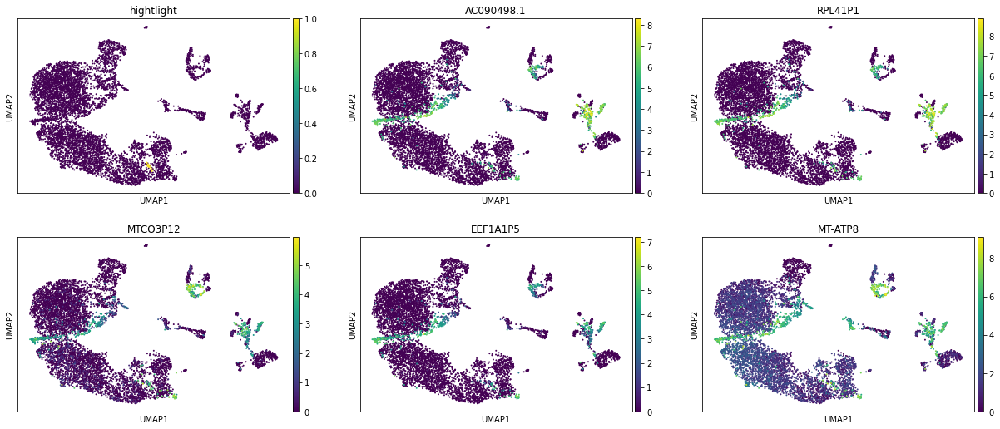

36


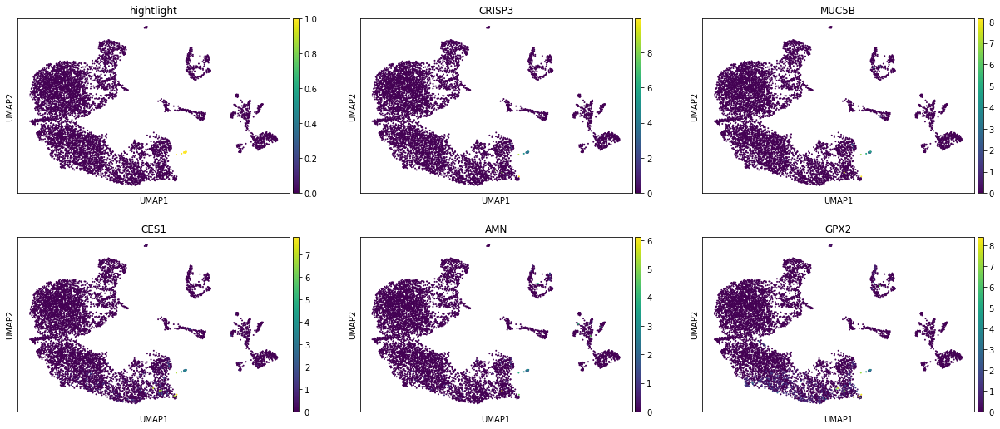

37


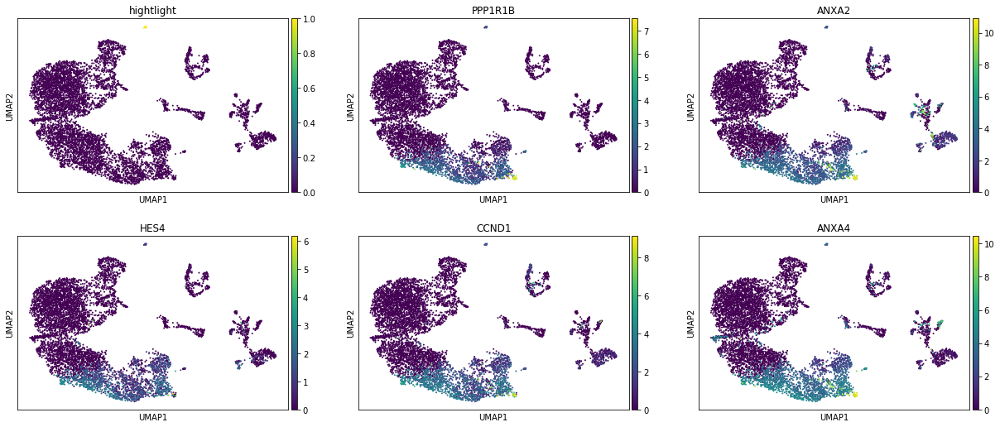

In [25]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [26]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
CTRL,16.128899,2.185108,9.410142e-54
PRSS3,15.881699,2.525802,2.497536e-52
PRSS1,14.329135,3.621384,1.694300e-42
PRSS2,14.104566,3.416871,3.492693e-41
CELA2B,14.007135,2.561655,1.185625e-40
...,...,...,...
CD44,-13.512078,-2.420063,7.102947e-38
TXNIP,-13.688303,-1.901552,7.801022e-39
ZBTB20,-13.701833,-2.003888,7.284658e-39
SORBS2,-14.679677,-2.190518,1.280475e-44


# read in cell ontology 

In [27]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [28]:
celltype_dict['T cell']

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [29]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-positive type I NK T cell secreting interferon-gamma',
 'CD4-positive, CXCR3-negative, CCR6-negative, alpha-beta T cell',
 'CD4-positive, alpha-beta memory T cell',
 'CD4-positive, CD25-positive, alpha-beta regulatory T cell',
 'CD4-positive helper T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interferon-gamma',
 'CD4-negative, CD8-negative, alpha-beta intraepithelial T cell',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'CD24-positive, CD4 single-positive thymocyte',
 'CD4-positive, alpha-beta thymocyte',
 'activated CD4-negative, CD8-negative type I NK T cell',
 'CD4-positive type I NK T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'effector CD4-positive, alpha-beta T cell',
 'CD4-intermediate, CD8-positive double-positive thymocyte',
 'activated CD4-positive, alpha-beta T cell, human',
 'CD69-positive, CD4-positive single-positive thymocyte',
 'CD4-positive, alpha-beta intraepithelial 

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [30]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [31]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-0.804914,-0.149632,-0.165111,1.992198
log fold change,-26.359507,-23.410921,-22.766788,-0.171690
adjusted pvalue,1.000000,1.000000,1.000000,0.351939


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



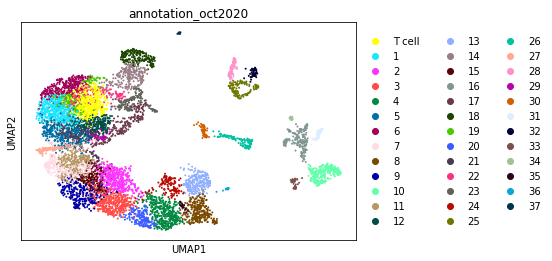

In [32]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [33]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

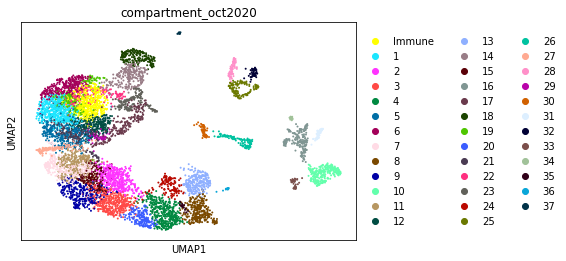

In [35]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [36]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)